In [12]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [84]:
from vector_fields import DavisSkodje, Duffing1D, DoubleGyre
import matplotlib.pyplot as plt
from grid import *
from solves import *
from plots import *
from tools import *
import random
import scipy
import seaborn as sns


/Users/jberman/sc/nca_lcs/plots.py:64: SyntaxWarning: "is not" with a literal. Did you mean "!="?
  if title is not '':


In [140]:
N = 150
grid = DavisSkodje_grid(N)
[(x_min, x_max, Nx), (y_min, y_max, Ny)] = grid
t_n = 1
ds_trajs, sol = integrate_ivp(DavisSkodje, grid, t_n, max_step=0.001, return_sol=True)
time = sol.t
m = len(time)  // 2
dt = time[m]- time[m-1]


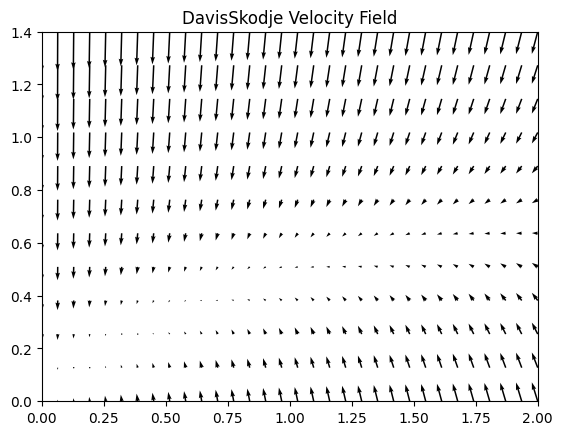

In [108]:
plot_vector_field(DavisSkodje, [(x_min, x_max, 32), (y_min, y_max, 12)], show=False)
plt.title('DavisSkodje Velocity Field')
plt.show()

In [142]:
from IPython.display import HTML

sub_t = ds_trajs[np.random.choice(ds_trajs.shape[0], 40, replace=False)]
sub_t = np.swapaxes(sub_t, 0, -1)
sub_t = np.swapaxes(sub_t, 1, -1)
frames = 300
sec = sub_t.shape[0] // frames
sub_t = sub_t[::sec]
print(sub_t.shape)
def plotter(d):
    plot_vector_field(DavisSkodje, [(x_min, x_max, 32), (y_min, y_max, 12)], show=False)
    plt.xlim([x_min, x_max])
    plt.ylim([y_min, y_max])
    for (x,y) in d:
        plt.scatter(x, y, marker='o', s=60, c='r')
    plt.title('Trajectories along DavisSkodje Velocity Field')

ani = make_plt_ani(plotter, sub_t)

HTML(ani.to_jshtml())


(335, 40, 2)


Animation size has reached 21015422 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [143]:
ani.save("ds_trajs.gif", writer='imagemagick',fps=60)

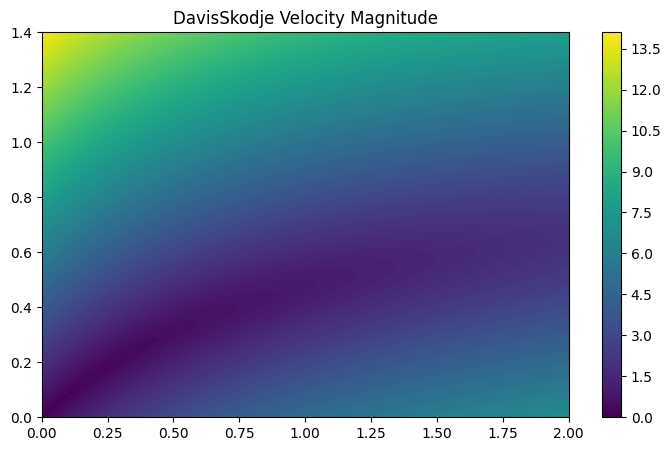

In [111]:

pts = get_point_array_from_grid(grid)
v = DavisSkodje(1, pts)
ds_vel = np.linalg.norm(v, axis=1)
plot_scalar_field(grid, ds_vel, size=(8.5,5), title='DavisSkodje Velocity Magnitude')

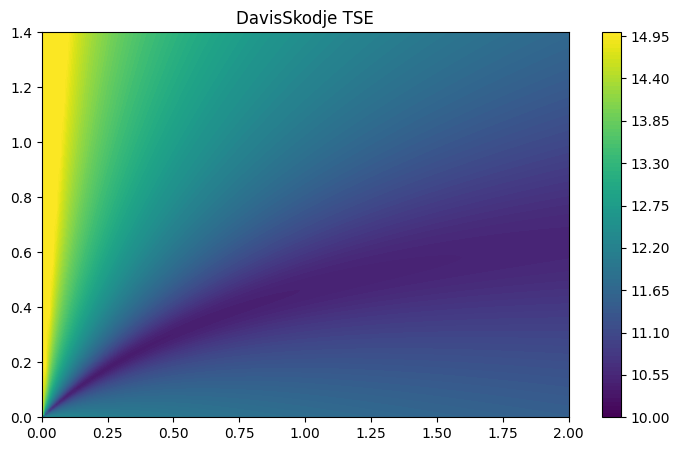

In [112]:
ds_tse = mean_tse(ds_trajs, dt)
ds_tse[ds_tse > 15] = 15
ds_tse[ds_tse < 10] = 10
plot_scalar_field(grid, ds_tse, size=(8.5,5), title='DavisSkodje TSE')


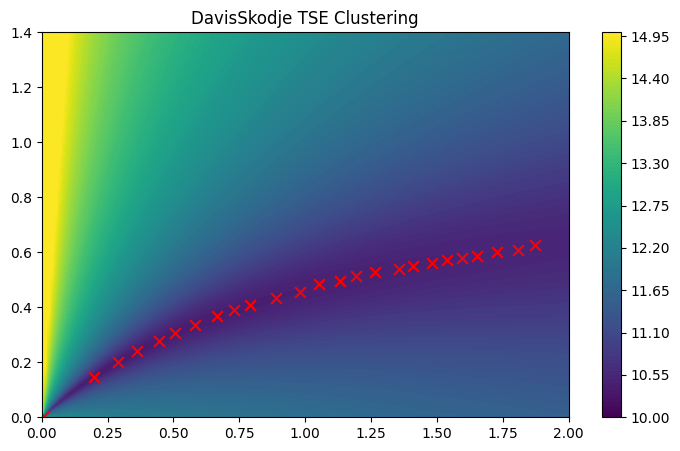

In [123]:
pts = get_point_array_from_grid(grid)
position, slowness = min_field_cluster(pts, ds_tse, 25, eta=0.3, alpha=1e-4, epochs=10)
plot_scalar_field(grid, ds_tse, size=(8.5,5), show=False)
for (x,y) in position:
    plt.scatter(x, y, marker='x', s=60, c='r')
plt.title('DavisSkodje TSE Clustering')
plt.show()




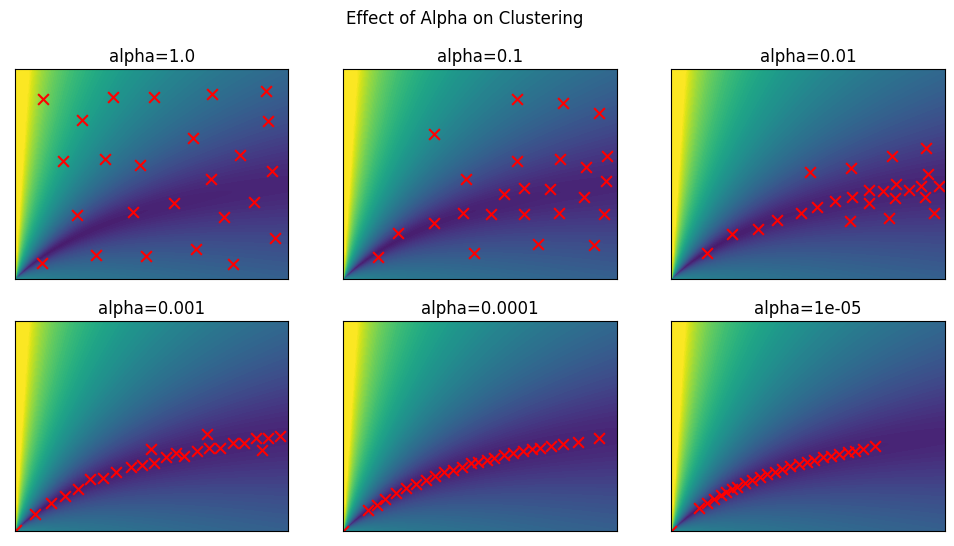

In [126]:

fig, axes = plt.subplots(2,3)
axes = axes.flat
for i, alpha in enumerate([1e0, 1e-1, 1e-2, 1e-3, 1e-4, 1e-5]):
    ax = axes[i]
    position, slowness = min_field_cluster(pts, ds_tse, 25, eta=0.2, alpha=alpha, epochs=30)

    ax.set_xticks([])
    ax.set_yticks([])
    # field
    ax1 = np.linspace(*grid[0])
    ax2 = np.linspace(*grid[1])
    zz = ds_tse.reshape(grid[0][-1], grid[1][-1])
    ax.contourf(ax1, ax2, zz, cmap='viridis', levels=100)

    for (x,y) in position:
        ax.scatter(x, y, marker='x', s=60, c='r')
    ax.set_title(f'alpha={alpha}')

fig.set_size_inches(12,6)
plt.suptitle('Effect of Alpha on Clustering')
plt.show()



In [125]:
from IPython.display import HTML

# making gif may take long time
position, slowness, history = min_field_cluster(pts, ds_tse, 25, eta=0.1, alpha=1e-4, epochs=3, return_history=True)
h_p, h_s = history
frames = 200
sec = len(h_p) // frames
data = h_p[::sec]
def plotter(d):
    plt.xlim([0, 2])
    plt.ylim([0, 1.4])
    plot_scalar_field(grid, ds_tse, show=False, colorbar=False)
    for (x,y) in d:
        plt.scatter(x, y, marker='x', s=60, c='r')
    plt.title('DavisSkodje TSE Clustering')


ani = make_plt_ani(plotter, data)

HTML(ani.to_jshtml())


In [127]:
ani.save("ds_cluster.gif", writer='imagemagick',fps=60)

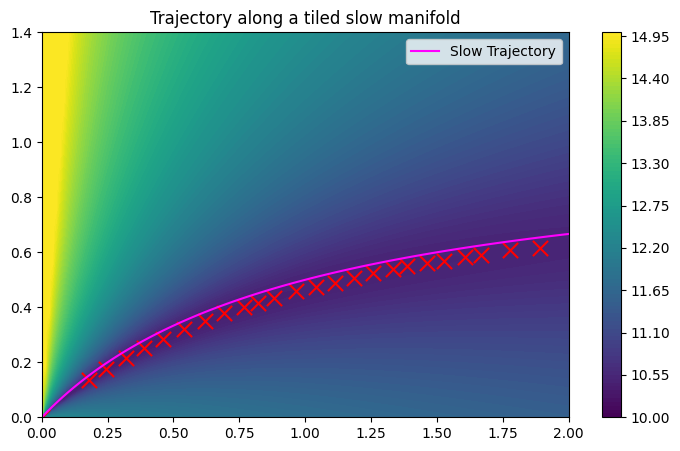

In [136]:
# make trajectory along slow manifold and cluster
plot_scalar_field(grid, ds_tse, size=(8.5,5), show=False)

# traverse slow manifold, equispaced in x
x_ld = np.linspace(0,2,100)
y_ld = x_ld/(1+x_ld)


ld_pts = np.swapaxes(np.vstack([x_ld, y_ld]),0,1)
plt.plot(x_ld, y_ld, c='magenta', label="Slow Trajectory")
centroids, _ = min_field_cluster(pts, ds_tse, 25, eta=0.2, alpha=1e-4, epochs=20)
for (x,y) in centroids:
    plt.scatter(x,y, marker='x', s=120, c='r')
plt.legend()
plt.title('Trajectory along a tiled slow manifold')
plt.show()

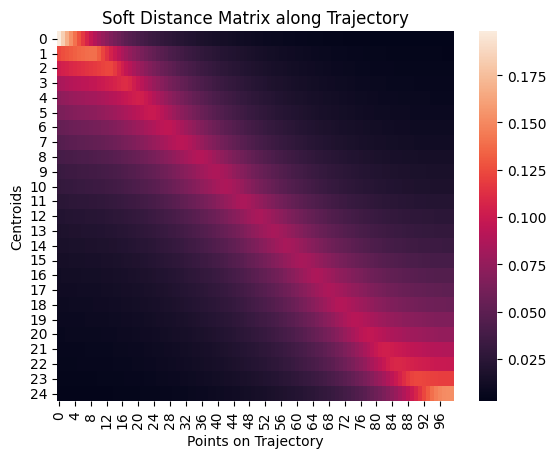

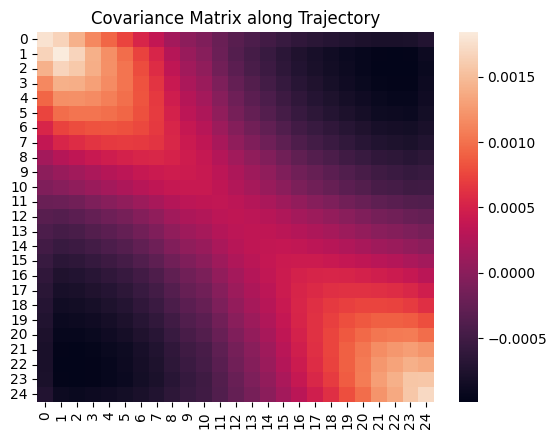

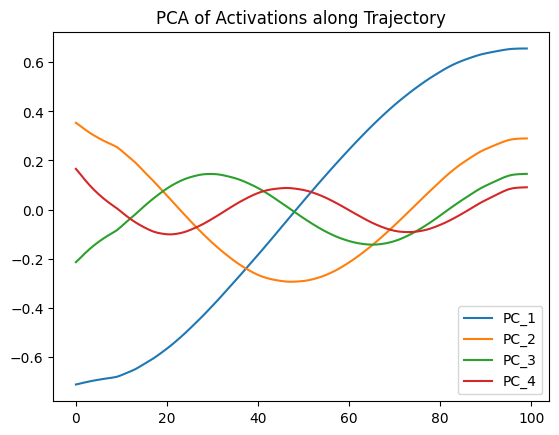

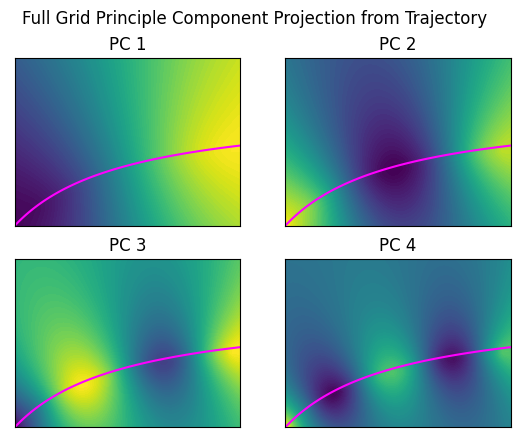

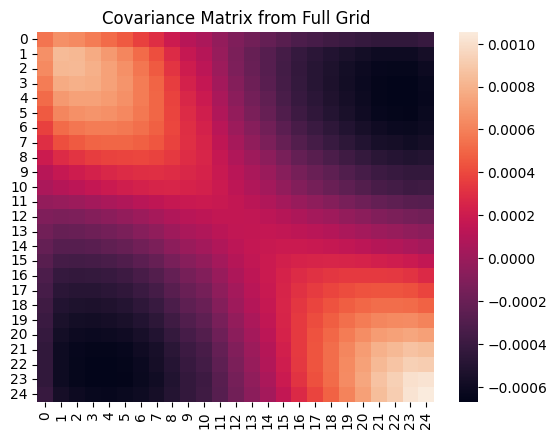

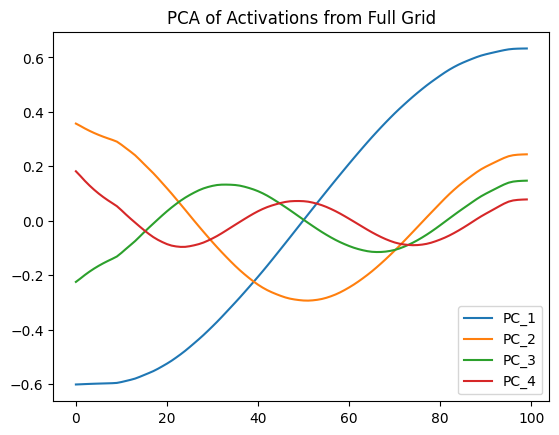

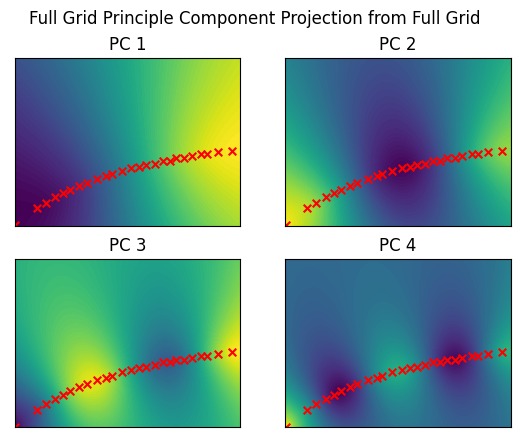

In [134]:
# compute activation from trajectory
soft_factor = 2
dist = scipy.spatial.distance.cdist(centroids, ld_pts)
soft_dist = scipy.special.softmax(dist*-1*soft_factor, axis=0)
s = np.argsort(np.argmax(soft_dist, axis=1))
soft_dist = soft_dist[s]

# also compute activation from full grid
pts = get_point_array_from_grid(grid)
dist_full = scipy.spatial.distance.cdist(centroids, pts)
soft_dist_full = scipy.special.softmax(dist_full*-1*soft_factor, axis=0)
soft_dist_full = soft_dist_full[s]

sns.heatmap(soft_dist)
plt.title('Soft Distance Matrix along Trajectory')
plt.xlabel('Points on Trajectory')
plt.ylabel('Centroids')
plt.show()


# center and pca
soft_dist -= soft_dist.mean(axis=1, keepdims=True)
cov = soft_dist @ soft_dist.T
cov /= soft_dist.shape[1]
w, vr = scipy.linalg.eig(cov)
vr = vr[:, np.argsort(w)[::-1]]

# plot cov
sns.heatmap(cov)
plt.title('Covariance Matrix along Trajectory')
plt.show()
# plot pca compoents
num_c = 4 
for i in range(num_c):
    pc = vr[:, i]
    pc /= pc[-1]
    plt.plot(pc @ soft_dist, label=f'PC_{i+1}')
plt.legend()
plt.title("PCA of Activations along Trajectory")
plt.show()

# look at scalar field of top PCA projection
fig, axes = plt.subplots(2,2)
axes = axes.flat
for i in range(num_c):
    ax = axes[i]
    pc = vr[:, i]
    proj = (pc @ soft_dist_full)
    plot_scalar_field_ax(grid, proj, ax)
    ax.plot(x_ld, y_ld, c='magenta', label="Slow Trajectory")
    ax.set_title(f'PC {i+1}')
    ax.set_xticks([])
    ax.set_yticks([])
plt.suptitle('Full Grid Principle Component Projection from Trajectory')
plt.show()

# center and pca
soft_dist_full -= soft_dist_full.mean(axis=1, keepdims=True)
cov_full = soft_dist_full @ soft_dist_full.T
cov_full /= soft_dist_full.shape[1]
w, vr = scipy.linalg.eig(cov_full)
vr = vr[:, np.argsort(w)[::-1]]

# plot cov
sns.heatmap(cov_full)
plt.title('Covariance Matrix from Full Grid')
plt.show()

# plot pca compoents
num_c = 4 
for i in range(num_c):
    pc = vr[:, i]
    pc /= pc[-1]
    plt.plot(pc @ soft_dist, label=f'PC_{i+1}') # project original soft_dist
plt.legend()
plt.title("PCA of Activations from Full Grid")
plt.show()


# look at scalar field of top PCA projection
fig, axes = plt.subplots(2,2)
axes = axes.flat
for i in range(num_c):
    ax = axes[i]
    pc = vr[:, i]
    proj = (pc @ soft_dist_full)
    plot_scalar_field_ax(grid, proj, ax)
    for (x,y) in centroids:
        ax.scatter(x,y, marker='x', s=30, c='r')
    ax.set_title(f'PC {i+1}')
    ax.set_xticks([])
    ax.set_yticks([])
plt.suptitle('Full Grid Principle Component Projection from Full Grid')
plt.show()

